In [3]:
import numpy as np
from tqdne.dataset import RepresentationDataset
from tqdne.conf import Config
config = Config()

In [5]:
from tqdne.representations import Signal

t = 5560
downsampling_factor = 2

dataset = RepresentationDataset(
    config.datasetdir / config.data_train, 
    Signal(), 
    pad = t
)

dataset_ds = RepresentationDataset(
    config.datasetdir / config.data_train, 
    Signal(), 
    pad = t,
    downsample = downsampling_factor
)

In [6]:
import plotly.subplots as sp
import plotly.graph_objects as go

def plot_decimation(signal_before, signal_after, title, dowsampling_factor=2, fs=100, eps=1e-9):
    fs_ds = fs // dowsampling_factor
    fig = sp.make_subplots(rows=3, cols=2, subplot_titles=[f'Channel {i}' for i in range(3)]*2)
    for i in range(3):
        assert(signal_before.shape[-1] == signal_after.shape[-1] * dowsampling_factor)
        time = np.arange(signal_before.shape[-1]) / fs
        time_ds = np.arange(signal_after.shape[-1]) / fs_ds
        fig.add_trace(go.Scatter(x=time, y=signal_before[i], mode='lines', name='Before Decimation', line=dict(color='blue'), showlegend=False), row=i+1, col=1)
        fig.add_trace(go.Scatter(x=time_ds, y=signal_after[i], mode='lines', name='After Decimation', line=dict(color='orange'), showlegend=False), row=i+1, col=1)
        # PSD plot
        #n_fft = signal_before.shape[-1]
        #freq = np.fft.rfftfreq(n_fft, d=1 / fs)
        #freq_ds = np.fft.rfftfreq(n_fft, d=1 / fs_ds)
        #fft_before = np.abs(np.fft.rfft(signal_before[i], n=n_fft))**2
        #fft_after = np.abs(np.fft.rfft(signal_after[i], n=n_fft))**2
        from scipy.signal import periodogram
        freq, fft_before = periodogram(signal_before[i], fs=fs)
        freq_ds, fft_after = periodogram(signal_after[i], fs=fs_ds)
        fig.add_trace(go.Scatter(x=freq, y=10*np.log10(fft_before + eps), mode='lines', name='Before Decimation', line=dict(color='blue'), showlegend=False), row=i+1, col=2)
        #fig.add_trace(go.Scatter(x=freq, y=fft_before, mode='lines', name='Before Decimation', line=dict(color='blue'), showlegend=False), row=i+1, col=2)
        fig.add_trace(go.Scatter(x=freq_ds, y=10*np.log10(fft_after + eps), mode='lines', name='After Decimation', line=dict(color='orange'), showlegend=False), row=i+1, col=2)
        #fig.add_trace(go.Scatter(x=freq_ds, y=fft_after, mode='lines', name='After Decimation', line=dict(color='orange'), showlegend=False), row=i+1, col=2)
        #fig.update_yaxes(type='log', row=i+1, col=2)
    fig.update_layout(height=1000, width=1600, title_text=title)
    fig.show()

In [17]:
plot_decimation(dataset[0]["waveform"], dataset_ds[0]["waveform"], 'Decimation by 2 (IIR) - Comparisons')

In [31]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = [10, 5]
mpl.rcParams['figure.dpi'] = 150
mpl.rcParams['font.size'] = 13

from scipy.signal import periodogram
import numpy as np

def plot_decimation(signal_before, signal_after, zoom_x_axis_sec, title=None, downsampling_factor=2, fs=100, eps=1e-9):
    fs_ds = fs // downsampling_factor
    fig, axs = plt.subplots(3, 2, figsize=(16, 10))
    for i in range(3):
        assert(signal_before.shape[-1] == signal_after.shape[-1] * downsampling_factor)
        time = np.arange(signal_before.shape[-1]) / fs
        time_ds = np.arange(signal_after.shape[-1]) / fs_ds
        axs[i, 0].plot(time, signal_before[i], label='Original Signal', color='blue')
        axs[i, 0].plot(time_ds, signal_after[i], label='Downsampled Signal', color='orange')
        axs[i, 0].set_title(f'Channel {i}')
        axs[i, 0].set_xlabel('Time [s]')
        axs[i, 0].set_ylabel('Amplitude')
        axs[i, 0].legend(loc='lower right')

        # Add zoomed subplot
        axins = axs[i, 0].inset_axes([0.5, 0.5, 0.47, 0.47])
        axins.plot(time, signal_before[i], label='Original Signal', color='blue')
        axins.plot(time_ds, signal_after[i], label='Downsampled Signal', color='orange')
        axins.set_xlim(*zoom_x_axis_sec)  # Limit the region for zoom

        # PSD plot
        freq, fft_before = periodogram(signal_before[i], fs=fs)
        freq_ds, fft_after = periodogram(signal_after[i], fs=fs_ds)
        axs[i, 1].plot(freq, 10*np.log10(fft_before + eps), label='Original Signal', color='blue')
        axs[i, 1].plot(freq_ds, 10*np.log10(fft_after + eps), label='Downsampled Signal', color='orange')
        axs[i, 1].set_title(f'Channel {i}')
        axs[i, 1].set_xlabel('Freq. [Hz]')
        axs[i, 1].set_ylabel('PSD [dB]')
        axs[i, 1].legend(loc='lower right')


    plt.tight_layout()
    if title:
        plt.suptitle(title, fontsize=16)
    plt.show()

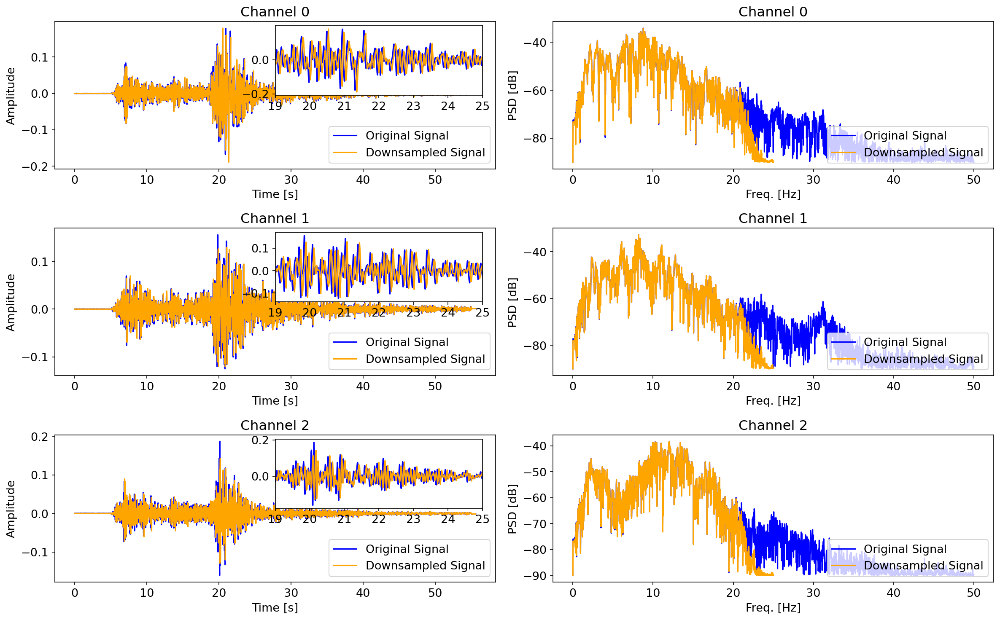

In [42]:
plot_decimation(dataset[37]["waveform"], dataset_ds[37]["waveform"], zoom_x_axis_sec=(19, 25))

In [4]:
plot_decimation(dataset[0]["waveform"], dataset_ds[0]["waveform"], 'Decimation by 2 (FIR) - Comparisons')

In [6]:
#TODO: replot
plot_decimation(dataset[0]["waveform"], dataset_ds[0]["waveform"], 'Decimation by 2 (Butter, n=10) - Comparisons')

In [5]:
#TODO: replot
plot_decimation(dataset[0]["waveform"], dataset_ds[0]["waveform"], f'Decimation by {downsampling_factor} (Butter, n=20) - Comparisons')

In [16]:
#TODO: replot
plot_decimation(dataset[0]["waveform"], dataset_ds[0]["waveform"], f'Decimation by {downsampling_factor} (Without anti-aliasing filter) - Comparisons')

In [5]:
from tqdne.conf import Config

Config().signal_length

5501